In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!pip install vietnam_number
!pip install underthesea


     |████████████████████████████████| 7.6 MB 11.2 MB/s 
     |████████████████████████████████| 965 kB 41.4 MB/s 
     |████████████████████████████████| 235 kB 54.6 MB/s 
     |████████████████████████████████| 581 kB 55.4 MB/s 


In [ ]:
import pandas as pd
import numpy as np
import tensorflow as tf
from underthesea import sent_tokenize
from underthesea import word_tokenize
from vietnam_number import n2w # đổi số sang chữ
import time
import collections # đếm số lượng
import pickle
import re
from gensim.models import Word2Vec
from keras.preprocessing import text
from keras.preprocessing.sequence import pad_sequences
from sklearn.model_selection import train_test_split
import gensim

#train model
from keras.layers import Input,LSTM,Embedding, Dropout, Dense, TimeDistributed, Attention

from tensorflow import keras

In [ ]:
check = [',','...','!','?',';',':','_','(',')','()','“', '”', '“”', '/', '\\', '>>', '>>>','"',
        '"', "'", "'", ',','-', '*', '%', '&', '≥', '≤']
def lower_word(the_list):
    return [value.lower() for value in the_list]

def remove_values_from_list(the_list,val):
#     check = [',','...','!','?',';',':','-','_','(',')','()','“', '”', '“”', '/', '\\', '>>', '>>>']
    return [value for value in the_list if value != val]

def convert_num_to_word(the_list):
    i=-1
    for value in the_list:
        i+=1
        try:
            if type(int(value)) == int:
                the_list[i] = n2w(value)
        except:
            the_list[i] = value
            continue


def load_stopword_txt():
    with open(r'/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/vietnamese-stopwords.txt','r', encoding="utf-8") as f:
        stopwords = f.readlines()
        stop_set = set(m.strip() for m in stopwords)
        return list(frozenset(stop_set))
    
def remove_stop_words(the_list):
    for stop_word in stopwords:
        if stop_word in the_list:
            the_list.remove(stop_word)
    
'''Chuyển về dạng nhị phân'''
def change_wordtoint(the_list):
    # Arrage the words from the most common to the least
    word_counter = collections.Counter(the_list).most_common()
    max_words=0 # chuỗi có nhiều từ nhất
    # Map each word to an integer
    word2int=dict()

    for word,_ in word_counter:
        index=len(word2int)
        word2int[word]=index
    int2word = dict(zip(word2int.values(), word2int.keys()))
    
    return word2int, int2word

def split_sent(sentence):
  sent_l =[]
  sent_word = []# toàn bộ word trong 1 list
  sent_list = []# chuỗi từng content đã tách chữ
  check_loi=[]
  c=-1
  for i in sentence:
    sent_l2 =[]
    c+=1
    for s in sent_tokenize(i):
      sent_l.append([s])# phân tách thành từng chuỗi câu trong list lồng list
    try:
      for w in word_tokenize(sent_l[c][0]):
        sent_l2.append(w) #phân tách chuỗi trong list
        sent_word.append(w)
    except:
      check_loi.append(c)
      continue
    sent_list.append(sent_l2)

  for i2 in check_loi:
    sent_list.pop(i2)
  return sent_word, sent_list

def pre_process(data): # padding = False kiểm tra content
    data = word_tokenize(data)
    data = lower_word(data)
    for v in check:
      # print('ok')
      data = remove_values_from_list(data, v)
    convert_num_to_word(data)
    remove_stop_words(data)
    data = ' '.join([str(item) for item in data])
    return data

# def change_seqint(the_list): # check false thì kiểm tra content
#     seq_int_list = list()
#     for s in the_list:
#         words = word_tokenize(s)
#         int_seq = [words_sum_int.get(word) for word in words]
#         seq_int_list.append(int_seq)
#     return seq_int_list
        
    

#PreProcess (ĐÃ xử lý rồi bỏ qua)

In [ ]:
train = pd.read_excel(r'/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/train_ttvb3.xlsx')

In [ ]:
train = train[:100]
# content = train_kt['content'][0]
# abstract = train_kt['abstract'][0]

In [ ]:
stopwords = load_stopword_txt()

In [ ]:
# test
for i in range (len(train)):
  train['content'][i] = pre_process(train['content'][i])


In [ ]:
for i in train.index:
  if len(train['abstract'][i]) <=20:
    train.drop(index=i,axis=0,inplace=True)
    train.reset_index(inplace=True,drop=True)
    i-=1


In [ ]:
train['abstract'][13]

In [ ]:
train.to_excel(r"/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/text_sum2(2)/train_ttvb_sach.xlsx", index=False, header=True) 

#Sau khi làm sạch

In [ ]:
train = pd.read_excel('/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/text_sum2(2)/train_ttvb_sach2.xlsx')

In [ ]:
len(train)

25220

In [ ]:
train2 = train[:]

# **Text generation**

## ..

In [ ]:
!pip install pyvi

     |████████████████████████████████| 8.5 MB 16.0 MB/s 


In [ ]:
import string
from pyvi import ViTokenizer

In [ ]:
def clean_text(the_list):
  content = ViTokenizer.tokenize(the_list)
  content = content.lower()
  tokens = content.split()
  # print(tokens)
  table = str.maketrans('', '', string.punctuation.replace("_", "")) # loại bỏ các dấu câu, .replace là để chuyển '_' về ' ' (mục đích để giữ '_' không bị mất) do hàm vitokenizer tách từ tiếng việt có '_' )
  
  tokens = [w.translate(table) for w in tokens]
  tokens = [word for word in tokens if word]
  return tokens

In [ ]:


sent_list = [] # danh sách từng nội dung content đã tách chữ
for i in train.index:
  train_clean = clean_text(train['content'][i])
  sent_list.append(train_clean)



In [ ]:
sent_list

[['quân_ủy',
  'trung_ương',
  '17',
  '1',
  'tổ_chức',
  'hội_nghị',
  'cán_bộ',
  'chủ_chốt',
  'toàn',
  'quân',
  'nghiên_cứu',
  'quán_triệt',
  'triển_khai',
  'kết_luận',
  'quy_định',
  'bch',
  'trung_ương',
  'đảng',
  'khóa',
  'xiii',
  'xây_dựng',
  'chỉnh_đốn',
  'đảng',
  'nghị_quyết',
  'của',
  'quân_ủy',
  'trung_ương',
  'về',
  'phát_huy',
  'phẩm_chất',
  'bộ_đội',
  'cụ',
  'hồ',
  'kiên_quyết',
  'chống',
  'chủ_nghĩa_tình_hình',
  'đại_tướng',
  'phan',
  'văn',
  'giang',
  'phó',
  'bí_thư',
  'quân_ủy',
  'trung_ương',
  'bộ_trưởng',
  'quốc_phòng',
  'chủ_trì',
  'hội_nghị',
  'cùng',
  'dự_ủy_viên',
  'trung_ương',
  'đảng',
  'thứ_trưởng',
  'quốc_phòng',
  'các',
  'phó_tổng',
  'tham_mưu_trưởng',
  'phó',
  'chủ_nhiệm',
  'tổng_cục',
  'chính_trị',
  'đại_diện',
  'lãnh_đạo',
  'ban_ngành',
  'cơ_quan',
  'trung_ương',
  'và',
  'các',
  'cơ_quan_chức_năng',
  'của',
  'bộ',
  'quốc_phòng',
  'hội_nghị',
  'diễn',
  'hình_thức',
  'kết_hợp',
  'trực_tuy

##Train model word2vec

In [ ]:
import multiprocessing
cores = multiprocessing.cpu_count() # Count the number of cores in a computer
print(cores)

2


In [ ]:

# from gensim.models import Word2Vec

w2vmodel = Word2Vec(size=300 , window=5, workers=cores, min_count=1)


In [ ]:
t = time.time()
w2vmodel.build_vocab(sent_list, progress_per=10000) #progress_per: Cho biết có bao nhiêu từ cần xử lý trước khi hiển thị / cập nhật tiến trình.
print('Time to build vocab: {} mins'.format(round((time.time() - t) / 60, 2)))

Time to build vocab: 0.47 mins


In [ ]:
t = time.time()
w2vmodel.train(sent_list, total_examples=w2vmodel.corpus_count, epochs=30)
print('Time to train vocab: {} mins'.format(round((time.time() - t) / 60, 2)))

Time to train vocab: 19.44 mins


In [ ]:
w2vmodel.save(r'/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/vocab_test_gener.model')

In [ ]:
w2vmodel.wv.most_similar('quân_ủy')

[('lasasimma_ủy_viên', 0.6713303327560425),
 ('pingkham', 0.6560624241828918),
 ('đảng_bộ_trưởng', 0.5645799040794373),
 ('quân_uỷ', 0.5417065024375916),
 ('hý_kịch', 0.5405121445655823),
 ('347900', 0.52107834815979),
 ('ngộ_độc_thần_kinh', 0.5083968639373779),
 ('phúc_ủy_viên', 0.5073582530021667),
 ('bcsđ', 0.505113422870636),
 ('13515', 0.5032454133033752)]

In [ ]:
for word, vocab_obj in w2vmodel.wv.vocab.items():
  #Do something with vocab_obj.count
  print(word)
  print(vocab_obj)

# Kiểm tra bao nhiêu từ trong 1 content
#MIn
#MAX


In [ ]:
test = clean_text(train['content'][0])
print(len(test))

372


## build model

In [ ]:
train2 = train[:250]
test2 = train[251:302]

In [ ]:
def c_sequences(data):
  seq_length=100
  sequences = []
  # sent_list = [] # danh sách từng nội dung content đã tách chữ
  for i in data.index:
    train_clean = clean_text(data['content'][i])
    # sent_list.append(train_clean)
    print(train_clean)
    for i2 in range(seq_length+1, len(train_clean)):
      seq = train_clean[i2-seq_length-1:i2]
      # print(seq)
      line = ' '.join(seq)
      # print(len(line))
      sequences.append(line) # chuỗi 51 từ trong cả danh sách
  return sequences

In [ ]:
sequences_train = c_sequences(train2)
sequences_test = c_sequences(test2)


['quân_ủy', 'trung_ương', '17', '1', 'tổ_chức', 'hội_nghị', 'cán_bộ', 'chủ_chốt', 'toàn', 'quân', 'nghiên_cứu', 'quán_triệt', 'triển_khai', 'kết_luận', 'quy_định', 'bch', 'trung_ương', 'đảng', 'khóa', 'xiii', 'xây_dựng', 'chỉnh_đốn', 'đảng', 'nghị_quyết', 'của', 'quân_ủy', 'trung_ương', 'về', 'phát_huy', 'phẩm_chất', 'bộ_đội', 'cụ', 'hồ', 'kiên_quyết', 'chống', 'chủ_nghĩa_tình_hình', 'đại_tướng', 'phan', 'văn', 'giang', 'phó', 'bí_thư', 'quân_ủy', 'trung_ương', 'bộ_trưởng', 'quốc_phòng', 'chủ_trì', 'hội_nghị', 'cùng', 'dự_ủy_viên', 'trung_ương', 'đảng', 'thứ_trưởng', 'quốc_phòng', 'các', 'phó_tổng', 'tham_mưu_trưởng', 'phó', 'chủ_nhiệm', 'tổng_cục', 'chính_trị', 'đại_diện', 'lãnh_đạo', 'ban_ngành', 'cơ_quan', 'trung_ương', 'và', 'các', 'cơ_quan_chức_năng', 'của', 'bộ', 'quốc_phòng', 'hội_nghị', 'diễn', 'hình_thức', 'kết_hợp', 'trực_tuyến', 'năm', 'mươi', 'mốt', 'cầu', 'trong', 'toàn', 'quân', 'đại_tướng', 'phan', 'văn', 'giang', 'bộ_trưởng', 'bộ', 'quốc_phòng', 'giới_thiệu', 'nội_dung'

['quân_ủy trung_ương 17 1 tổ_chức hội_nghị cán_bộ chủ_chốt toàn quân nghiên_cứu quán_triệt triển_khai kết_luận quy_định bch trung_ương đảng khóa xiii xây_dựng chỉnh_đốn đảng nghị_quyết của quân_ủy trung_ương về phát_huy phẩm_chất bộ_đội cụ hồ kiên_quyết chống chủ_nghĩa_tình_hình đại_tướng phan văn giang phó bí_thư quân_ủy trung_ương bộ_trưởng quốc_phòng chủ_trì hội_nghị cùng dự_ủy_viên trung_ương đảng thứ_trưởng quốc_phòng các phó_tổng tham_mưu_trưởng phó chủ_nhiệm tổng_cục chính_trị đại_diện lãnh_đạo ban_ngành cơ_quan trung_ương và các cơ_quan_chức_năng của bộ quốc_phòng hội_nghị diễn hình_thức kết_hợp trực_tuyến năm mươi mốt cầu trong toàn quân đại_tướng phan văn giang bộ_trưởng bộ quốc_phòng giới_thiệu nội_dung cơ_bản trong kết_luận hai mươi mốt của hội_nghị',
 'trung_ương 17 1 tổ_chức hội_nghị cán_bộ chủ_chốt toàn quân nghiên_cứu quán_triệt triển_khai kết_luận quy_định bch trung_ương đảng khóa xiii xây_dựng chỉnh_đốn đảng nghị_quyết của quân_ủy trung_ương về phát_huy phẩm_chất bộ_đ

In [ ]:
tokenizer_train = keras.preprocessing.text.Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^`{|}~ ')
tokenizer_train.fit_on_texts(sequences_train)

tokenizer_test = keras.preprocessing.text.Tokenizer(filters='!"#$%&()*+,-./:;<=>?@[\]^`{|}~ ')
tokenizer_test.fit_on_texts(sequences_test)


In [ ]:
sequences_digit_train = tokenizer_train.texts_to_sequences(sequences_train)
sequences_digit_test = tokenizer_test.texts_to_sequences(sequences_test)
# sequences_digit

In [ ]:
sequences_digit_train

[[858,
  39,
  1461,
  266,
  30,
  164,
  50,
  1746,
  175,
  549,
  227,
  723,
  78,
  284,
  71,
  3426,
  39,
  20,
  228,
  245,
  27,
  410,
  20,
  83,
  3,
  858,
  39,
  13,
  187,
  994,
  927,
  1570,
  237,
  722,
  270,
  6973,
  546,
  883,
  233,
  1277,
  132,
  118,
  858,
  39,
  156,
  232,
  831,
  164,
  253,
  6495,
  39,
  20,
  577,
  232,
  2,
  4223,
  3343,
  132,
  646,
  1214,
  57,
  591,
  60,
  1572,
  82,
  39,
  1,
  2,
  1176,
  3,
  22,
  232,
  164,
  907,
  432,
  750,
  762,
  15,
  9,
  90,
  972,
  5,
  175,
  549,
  546,
  883,
  233,
  1277,
  156,
  22,
  232,
  1193,
  196,
  317,
  5,
  284,
  4,
  9,
  90,
  3,
  164],
 [39,
  1461,
  266,
  30,
  164,
  50,
  1746,
  175,
  549,
  227,
  723,
  78,
  284,
  71,
  3426,
  39,
  20,
  228,
  245,
  27,
  410,
  20,
  83,
  3,
  858,
  39,
  13,
  187,
  994,
  927,
  1570,
  237,
  722,
  270,
  6973,
  546,
  883,
  233,
  1277,
  132,
  118,
  858,
  39,
  156,
  232,
  831,
  164,
  25

In [ ]:
vocab_size = len(set(tokenizer_train.word_index)) + 1
vocab_size

7279

In [ ]:
# separate into input and output
# max_sequence_len = max([len(seq) for seq in sequences_digit])
# print(max_sequence_len)
sequences_digit_train = np.array(sequences_digit_train)
sequences_digit_test = np.array(sequences_digit_test)

In [ ]:
input_sequences, labels = sequences_digit_train[:,:-1], sequences_digit_train[:,-1]
one_hot_labels = keras.utils.to_categorical(labels, num_classes=vocab_size)
seq_length = input_sequences.shape[1]

input_sequences_test, labels_test = sequences_digit_test[:,:-1], sequences_digit_test[:,-1]
one_hot_labels_test = keras.utils.to_categorical(labels_test, num_classes=vocab_size)
# seq_length = input_sequences_test.shape[1]

In [ ]:
print(labels.shape)
print(input_sequences.shape)
print(one_hot_labels.shape)
print(seq_length)

print(labels_test.shape)
print(input_sequences_test.shape)
print(one_hot_labels_test.shape)



(154546,)
(154546, 100)
(154546, 7279)
100
(29695,)
(29695, 100)
(29695, 7279)


In [ ]:
input_sequences_50000=input_sequences[:50000]
one_hot_labels_50000 = one_hot_labels[:50000]
print(input_sequences_50000.shape)
print(one_hot_labels_50000.shape)

(50000, 100)
(50000, 8435)


In [ ]:
Xtrain, Xtest, y_train, y_test = train_test_split(input_sequences_50000, one_hot_labels_50000, test_size=0.2, random_state=0)

In [ ]:
print(Xtrain.shape)
print(Xtest.shape)
print(y_train.shape)
print(y_test.shape)

(40000, 100)
(10000, 100)
(40000, 8435)
(10000, 8435)


In [ ]:
model_embedding = gensim.models.Word2Vec.load("/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/vocab_test_gener.model")

In [ ]:
# Chuẩn bị embedding matrix
max_word = 100000
words_not_found_vector = []
words_not_found = []
embedding_dim = 300 # Dimension of word_embeddings
num_word = min(max_word,len(tokenizer_train.word_index)+1) # tổng số lượng từ thấp nhất

# Với mỗi từ trong câu lưu lại word vector phụ để huấn luyện mô hình (embedding vector)
embedding_matrix = np.zeros((num_word, embedding_dim))
for word, i in tokenizer_train.word_index.items(): # lấy ra key và value
  try:
    # model_embedding chứa giá trị xác suất của từ liên quan 
    embedding_vector = model_embedding[word] # model_embedding là embedding_index chứa các index
  except:
    words_not_found_vector.append(word) # Do lấy min_count=2 nên có thể chủ nghĩa tình hình có 1 nên bị loại bỏ
  if (embedding_vector is not None) and len(embedding_vector) > 0: # word có
    embedding_matrix[i] = embedding_vector
  else: # word ko có từ liên quan trong embedding_vector
    words_not_found.append(word)
print('words không tìm thấy các từ liên quan trong vector: ', words_not_found)
print('words không tìm thấy các từ liên quan trong w2id: ', words_not_found_vector)

words không tìm thấy các từ liên quan trong vector:  []
words không tìm thấy các từ liên quan trong w2id:  []


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  del sys.path[0]


# model RNN,LSTM

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense, Bidirectional
from keras.initializers import Constant

model = Sequential()
model.add(Embedding(vocab_size, output_dim=300, input_length=seq_length, embeddings_initializer=Constant(embedding_matrix)))
model.add(Bidirectional(LSTM(300)))
model.add(Dense(vocab_size, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 100, 300)          2530500   
                                                                 
 bidirectional (Bidirectiona  (None, 600)              1442400   
 l)                                                              
                                                                 
 dense (Dense)               (None, 8435)              5069435   
                                                                 
Total params: 9,042,335
Trainable params: 9,042,335
Non-trainable params: 0
_________________________________________________________________


In [ ]:
from keras.callbacks import ModelCheckpoint
filepath = "model_weights_saved.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='loss', verbose=1, save_best_only=True, mode='min')
desired_callbacks = [checkpoint]

In [ ]:
history = model.fit(Xtrain, y_train, epochs=10, batch_size=128, callbacks=desired_callbacks, validation_data=(Xtest, y_test) )
# history = model.fit(input_sequences_train, one_hot_labels_train, batch_size=128, epochs=1, validation_data=(input_sequences_test,one_hot_labels_test))

Epoch 1/10
313/313 [==============================] - ETA: 0s - loss: 6.2843 - accuracy: 0.1010
Epoch 1: loss improved from inf to 6.28432, saving model to model_weights_saved.hdf5
313/313 [==============================] - 985s 3s/step - loss: 6.2843 - accuracy: 0.1010 - val_loss: 5.5547 - val_accuracy: 0.1457
Epoch 2/10
313/313 [==============================] - ETA: 0s - loss: 4.7191 - accuracy: 0.1981
Epoch 2: loss improved from 6.28432 to 4.71911, saving model to model_weights_saved.hdf5
313/313 [==============================] - 976s 3s/step - loss: 4.7191 - accuracy: 0.1981 - val_loss: 5.0964 - val_accuracy: 0.1909
Epoch 3/10
313/313 [==============================] - ETA: 0s - loss: 3.6091 - accuracy: 0.2979
Epoch 3: loss improved from 4.71911 to 3.60910, saving model to model_weights_saved.hdf5
313/313 [==============================] - 975s 3s/step - loss: 3.6091 - accuracy: 0.2979 - val_loss: 5.0091 - val_accuracy: 0.1989
Epoch 4/10
313/313 [==============================] -

In [ ]:
model.save('/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/text_sum2(2)/model_generation.h5')

In [ ]:
history_dict = history.history

acc = history_dict['accuracy']
val_acc = history_dict['val_accuracy']
loss = history_dict['loss']
val_loss = history_dict['val_loss']
epochs = range(1, len(acc)+1)

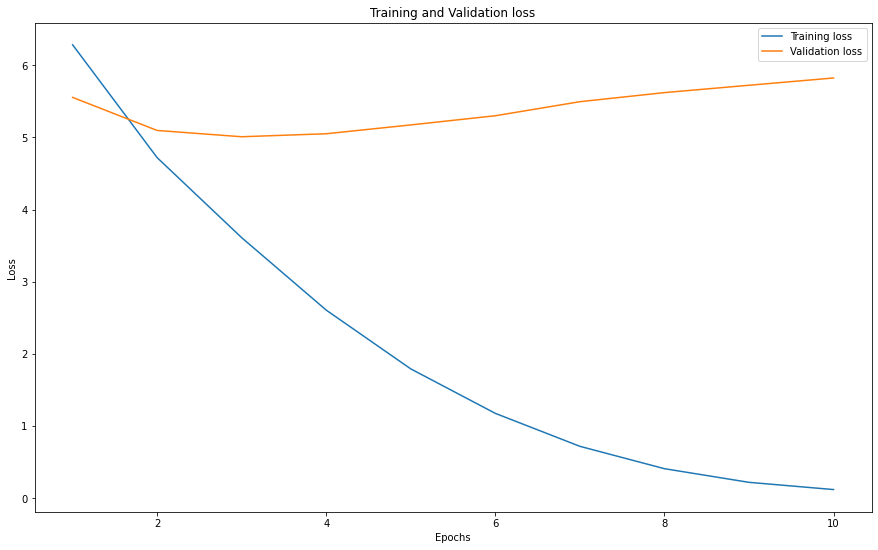

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,9))
plt.plot(epochs, loss, label='Training loss')
plt.plot(epochs, val_loss, label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Model 2

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense, Bidirectional
from keras.initializers import Constant

model = Sequential()
model.add(Embedding(vocab_size, output_dim=300, input_length=seq_length, embeddings_initializer=Constant(embedding_matrix)))
model.add(Bidirectional(LSTM(256,return_sequences=True)))
model.add(Dropout(0.2))
model.add(Bidirectional(LSTM(256)))
model.add(Dropout(0.2))
model.add(Dense(vocab_size, activation='softmax'))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 100, 300)          2530500   
                                                                 
 bidirectional (Bidirectiona  (None, 100, 512)         1140736   
 l)                                                              
                                                                 
 dropout (Dropout)           (None, 100, 512)          0         
                                                                 
 bidirectional_1 (Bidirectio  (None, 512)              1574912   
 nal)                                                            
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense (Dense)               (None, 8435)              4

In [ ]:
from keras.callbacks import ModelCheckpoint
filepath = "model_weights_saved.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='loss', verbose=1, save_best_only=True, mode='min')
desired_callbacks = [checkpoint]

In [ ]:
history = model.fit(Xtrain, y_train, epochs=10, batch_size=128, callbacks=desired_callbacks, validation_data=(Xtest, y_test) )
# history = model.fit(input_sequences_train, one_hot_labels_train, batch_size=128, epochs=1, validation_data=(input_sequences_test,one_hot_labels_test))

Epoch 1/10
313/313 [==============================] - ETA: 0s - loss: 6.6817 - accuracy: 0.0560
Epoch 1: loss improved from inf to 6.68174, saving model to model_weights_saved.hdf5
313/313 [==============================] - 2077s 7s/step - loss: 6.6817 - accuracy: 0.0560 - val_loss: 6.1798 - val_accuracy: 0.0823
Epoch 2/10
313/313 [==============================] - ETA: 0s - loss: 5.7426 - accuracy: 0.1164
Epoch 2: loss improved from 6.68174 to 5.74258, saving model to model_weights_saved.hdf5
313/313 [==============================] - 2027s 6s/step - loss: 5.7426 - accuracy: 0.1164 - val_loss: 5.6486 - val_accuracy: 0.1347
Epoch 3/10
313/313 [==============================] - ETA: 0s - loss: 5.1116 - accuracy: 0.1613
Epoch 3: loss improved from 5.74258 to 5.11156, saving model to model_weights_saved.hdf5
313/313 [==============================] - 2040s 7s/step - loss: 5.1116 - accuracy: 0.1613 - val_loss: 5.3682 - val_accuracy: 0.1574
Epoch 4/10
313/313 [==============================

In [ ]:
model.save('/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/text_sum2(3)/model_generation.h5')

In [ ]:
history_dict = history.history

acc = history_dict['accuracy']
val_acc = history_dict['val_accuracy']
loss = history_dict['loss']
val_loss = history_dict['val_loss']
epochs = range(1, len(acc)+1)

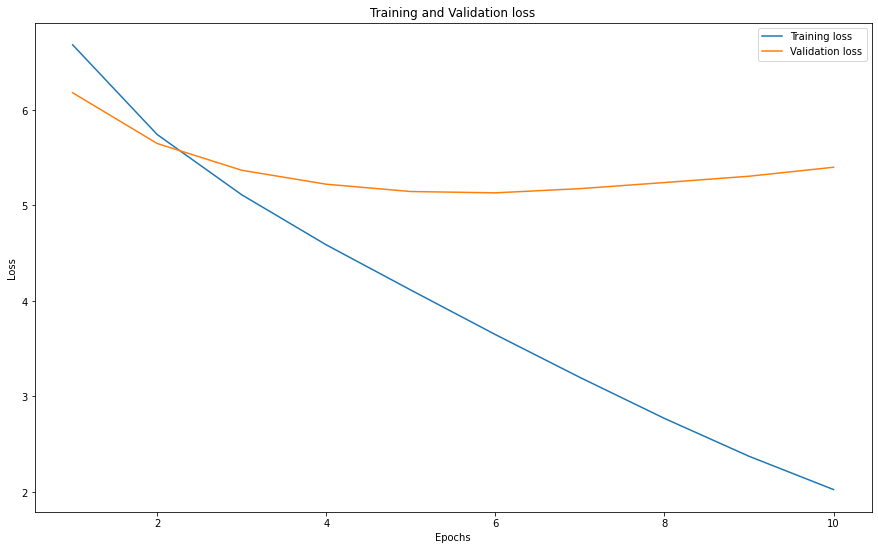

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,9))
plt.plot(epochs, loss, label='Training loss')
plt.plot(epochs, val_loss, label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# model using attention


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense, Bidirectional, Input,Lambda, concatenate
from keras.initializers import Constant
from tensorflow.keras.models import Model
from keras.layers import Layer
import keras.backend as K
class attention(Layer):
    def __init__(self,**kwargs):
        super(attention,self).__init__(**kwargs)

    def build(self,input_shape):
        self.W=self.add_weight(name="att_weight",shape=(input_shape[-1],1),initializer="normal")
        self.b=self.add_weight(name="att_bias",shape=(input_shape[1],1),initializer="zeros")        
        super(attention, self).build(input_shape)

    def call(self,x):
        et=K.squeeze(K.tanh(K.dot(x,self.W)+self.b),axis=-1)
        at=K.softmax(et)
        at=K.expand_dims(at,axis=-1)
        output=x*at
        return K.sum(output,axis=1)

    def compute_output_shape(self,input_shape):
        return (input_shape[0],input_shape[-1])

    def get_config(self):
        return super(attention,self).get_config()

In [ ]:
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Embedding, LSTM, Dense, Bidirectional, Flatten
from keras.initializers import Constant


inputs=Input(shape=(seq_length,))
x=Embedding(input_dim=vocab_size, output_dim=300, input_length=seq_length, embeddings_initializer=Constant(embedding_matrix))(inputs)
att_in=Bidirectional(LSTM(256, return_sequences=True, dropout=0.2))(x)
att_out=attention()(att_in)
outputs=Dense(vocab_size, activation='softmax', trainable=True)(att_out)
model2=Model(inputs,outputs)
model2.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model2.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 100)]             0         
                                                                 
 embedding_1 (Embedding)     (None, 100, 300)          2183700   
                                                                 
 bidirectional (Bidirectiona  (None, 100, 512)         1140736   
 l)                                                              
                                                                 
 attention (attention)       (None, 512)               612       
                                                                 
 dense (Dense)               (None, 7279)              3734127   
                                                                 
Total params: 7,059,175
Trainable params: 7,059,175
Non-trainable params: 0
___________________________________________________

In [ ]:
from keras.callbacks import ModelCheckpoint
filepath = "model_weights_saved3.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='loss', verbose=1, save_best_only=True, mode='min')
desired_callbacks = [checkpoint]

In [ ]:
history = model2.fit(input_sequences, one_hot_labels, epochs=6, batch_size=200, callbacks=desired_callbacks, validation_data=(input_sequences_test, one_hot_labels_test) )
# history = model.fit(input_sequences_train, one_hot_labels_train, batch_size=128, epochs=1, validation_data=(input_sequences_test,one_hot_labels_test))

Epoch 1/6
773/773 [==============================] - ETA: 0s - loss: 4.9361 - accuracy: 0.1674
Epoch 1: loss improved from inf to 4.93612, saving model to model_weights_saved3.hdf5
773/773 [==============================] - 3112s 4s/step - loss: 4.9361 - accuracy: 0.1674 - val_loss: 8.1516 - val_accuracy: 0.0089
Epoch 2/6
773/773 [==============================] - ETA: 0s - loss: 4.3371 - accuracy: 0.2153
Epoch 2: loss improved from 4.93612 to 4.33713, saving model to model_weights_saved3.hdf5
773/773 [==============================] - 3024s 4s/step - loss: 4.3371 - accuracy: 0.2153 - val_loss: 8.4278 - val_accuracy: 0.0080
Epoch 3/6
773/773 [==============================] - ETA: 0s - loss: 3.9146 - accuracy: 0.2520
Epoch 3: loss improved from 4.33713 to 3.91464, saving model to model_weights_saved3.hdf5
773/773 [==============================] - 3032s 4s/step - loss: 3.9146 - accuracy: 0.2520 - val_loss: 8.7132 - val_accuracy: 0.0073
Epoch 4/6
773/773 [==============================]

In [ ]:
model2.save('/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/text_sum2(4)/model_generation.h5')

In [ ]:
history_dict = history.history

acc = history_dict['accuracy']
val_acc = history_dict['val_accuracy']
loss = history_dict['loss']
val_loss = history_dict['val_loss']
epochs = range(1, len(acc)+1)

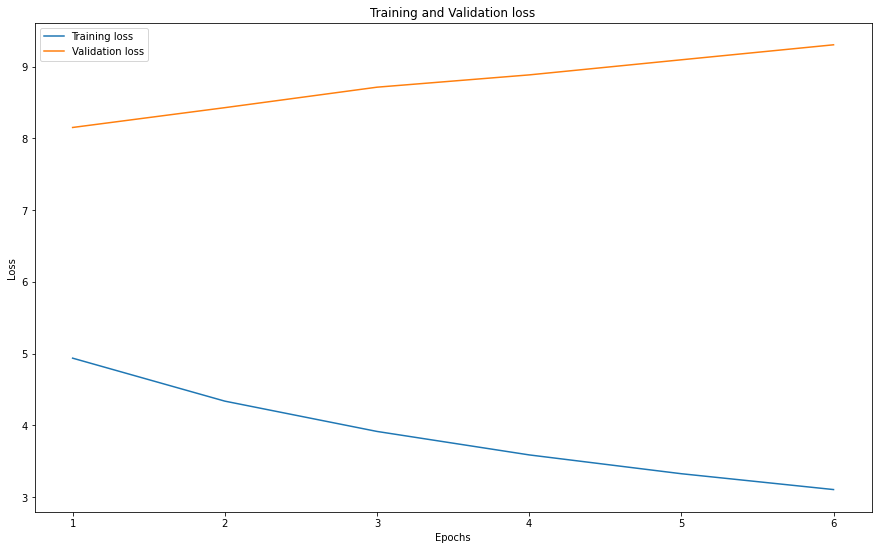

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15,9))
plt.plot(epochs, loss, label='Training loss')
plt.plot(epochs, val_loss, label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
import pickle
pickle.dump(model2, open('/content/gdrive/MyDrive/NLP/model2.pkl','wb'))

INFO:tensorflow:Assets written to: ram://b91b3180-22bc-474e-8f79-df75aade3473/assets


INFO:tensorflow:Assets written to: ram://b91b3180-22bc-474e-8f79-df75aade3473/assets


In [ ]:
import pickle
with open('/content/gdrive/MyDrive/NLP/tokenizer_train.pkl', 'wb') as f:
    pickle.dump(tokenizer_train, f)

with open('/content/gdrive/MyDrive/NLP/sequences_digit_train.pkl', 'wb') as f:
    pickle.dump(sequences_digit_train, f)

In [ ]:
import pickle
pickle.dump(history, open('/content/gdrive/MyDrive/NLP/model2_history.pkl','wb'))

INFO:tensorflow:Assets written to: ram://3b3a342b-3cbb-4ec5-84e8-5e1740b55112/assets


INFO:tensorflow:Assets written to: ram://3b3a342b-3cbb-4ec5-84e8-5e1740b55112/assets


In [ ]:
from keras.models import load_model

model3 = pickle.load(open('/content/gdrive/MyDrive/NLP/model2.pkl','rb'))

with open('/content/gdrive/MyDrive/NLP/tokenizer_train.pkl', 'rb') as f:
    tokenizer = pickle.load(f)
    
with open('/content/gdrive/MyDrive/NLP/sequences_digit_train.pkl', 'rb') as f:
    sequences_digit = pickle.load(f)

model = load_model('/content/gdrive/MyDrive/Xử lý ngôn ngữ tự nhiên/text_sum2(3)/model_generation.h5')

In [ ]:
def preprocess_input(doc):
    tokens = clean_text(doc)
    tokens = tokenizer.texts_to_sequences(tokens)
    tokens = keras.preprocessing.sequence.pad_sequences([tokens], maxlen=100, truncating='pre')
    return np.reshape(tokens, (1,100))

In [ ]:
def generate_text(text_input, n_words):
    tokens = preprocess_input(text_input)
    for _ in range(n_words):
        next_digit = np.argmax(model.predict(tokens), axis=1)
        tokens = np.append(tokens, next_digit)
        tokens = np.delete(tokens, 0)
        tokens = np.reshape(tokens, (1, 100))
    
    # Mapping to text  
    tokens = np.reshape(tokens, (100))
    out_word = []
    for token in tokens:
        for word, index in tokenizer.word_index.items():
            if index == token:
                out_word.append(word)
                break

    return ' '.join(out_word)

In [ ]:
seq ='liên đoàn lao động tphcm chủ trì họp báo '
generate_text(seq, 100)

'nhiệm hết với 6 ủy_viên chương_trình điều_kiện chính_sách việc covid dịch đảng_viên hết nghề_nghiệp việc covid dịch giải_ngân xã_hội usd bị covid dịch giải_ngân việc covid dịch giải_ngân bị covid dịch giải_ngân bị covid dịch giải_ngân bị covid dịch giải_ngân việc covid dịch giải_ngân bị covid dịch giải_ngân bị covid dịch giải_ngân bị covid dịch giải_ngân việc covid dịch giải_ngân bị covid dịch giải_ngân việc covid dịch giải_ngân việc covid dịch giải_ngân xã_hội tỉnh đảng_viên hết xã_hội phục_vụ giao_thông thủ_tướng và trăm trên bảo_vệ đảng_viên hết hơn việc covid dịch đảng_viên hết hết với việc covid dịch và trăm trên'